## Problem Analysis

I believe the given problem lies within the broad domain of `object detection` and `instance segmentation`. Since we need to detect and classify the type of structure(s) present and also be able to generate a closed-polygon around the object of interest.

Based on the annotation data available:
- I will address the problem using `Mask_RCNN`, a state-of-the-art object detection and segmentation method. Reference [https://github.com/matterport/Mask_RCNN]
- I also worked on a new segmentation model from scratch using the pre-trained models, however due to time and GPU constraint, the results obtained are limited to only `semantically segment` the object of interest(s). Please find the kaggle link [https://www.kaggle.com/avasalya/segmentation], for semantic segmentation approach.



## Approach

- I noticed, annotation data doesn't contain `bounding box` of the object of interest, therefore I will first extract closed-bounding box from the given segmentation polygon coordinates using `OpenCV` library.

- The input images are huge in size and due to GPU limitations, input images needs to be resized/scaled down to handle batch_size of atleast 2.

- I have created a `SatelliteDataset` Class to load, process, scale the given dataset and also to generate mask images.

- The corresponding mask image has same (H x W x C) as resize-colored image and the number of channels `C` corresponds to the total no of object polygons present within each frame.

- There are 4 classes in total, namely ('Bg', 'Houses', 'Buildings', 'Sheds/Garages')

- Since our images are huge and many of the object of interest are very small, therefore I have selected RPN (region proposal network) anchor scale range as (8, 16, 32, 64, 128). This range should be able to identify both small and huge objects.

- The datasets were randomly divided using `Sklearn` library.

- Losses used within Mask RCNN, all losses had default starting value of 1.
  - rpn_class_loss : Region Proposal Network, which separates background with objects
  - rpn_bbox_loss : Measures RPN's ability to localize objects
  - mrcnn_bbox_loss : Measures Mask RCNN's ability to localize objects
  - mrcnn_class_loss : How well the Mask RCNN recognize each class of object
  - mrcnn_mask_loss : How well the Mask RCNN segment objects
  - loss : A combination of all the above losses.


- I have trained and tested the Mask_RCNN base-model with the following variations of hyper-parameters using `TensorFlow 1.5`:

  - V1: pre-trained coco, lr =0.001 data-split (80, 20), STEPS_PER_EPOCH=100, VALIDATION_STEPS=5, heads->all_layers epochs 10, 40
  - V2: pre-trained coco, lr =0.001 data-split (80, 20), STEPS_PER_EPOCH=200, VALIDATION_STEPS=10, heads->all_layers epochs 40, 60
  - V3: pre-trained imagenet, lr =0.01  data-split (80, 20), STEPS_PER_EPOCH=200, VALIDATION_STEPS=15, heads->all_layers epochs 50, 100
  - V4: pre-trained coco, lr =0.01  data-split (60, 40), STEPS_PER_EPOCH=150, VALIDATION_STEPS=20, heads->all_layers epochs 30, 60
  - V5: pre-trained imagenet, lr =0.001 data-split (70, 30), STEPS_PER_EPOCH=1000, VALIDATION_STEPS=50, heads->res4+->all_layers epochs 50,100,131



## Results & Conclusion

- Since our dataset is small and the number of object of interest are huge (in some samples total no of instances are more than 600). We have possible issue of `overtfitting`, which can be seen in the `validation loss curves`. (see section EVALUATION [block 9 onwards])
  - The overtfitting mainly occurs in the `Class` and `Mask` losses. Doing a sanity check, this is however understandable since our dataset is small and there is a huge class imbalance.

- Within all 5 versions as mentioned above, I have tried to address the issue by tuning hyper-parameters. V5 (*this notebook*) has the most promising result.

- The mean APs on all validation dataset samples is ***0.44*** which is acceptable, however addressing overtfitting issue can considerably improve the performance.

- The Precision-Recall with AP@50 is ***0.3***.

- Please go through section ***EVALUATION*** for further results/figures.

- The trained model is tested on 9 (non annotated) samples which were not part of training and validation datasets.

- The output of the model is `json file` with the following format.
   
```
{'filename':file_name,

'labels': [{'name': label_name, 'annotations': [{'id':some_unique_integer_id, 'segmentation':[x,y,x,y,x,y....]}
                                             ....] }
        ....]
}
```





## Hurdles
- I believe, the problem of `overtfitting` needs to be addressed thoroughly. However it is difficult to address it with the small size of given dataset and GPU constraint.

- Moreoever, in the given dataset, there is a huge `class imbalance` problem, especially with the class `sheds/garages`. In most samples, the no of instances are in the ratio (approximate) of 5:10:1 (houses:buildings:garages)

- Since the input images are huge in size, both the `Kaggle` and `Google colab` can't handle batch size of more than 2, even after resizing the images to (512, 512). lowering further will reduce the resolution and hence more difficult to extract relevant features.

- I believe, having access to a powerful GPU is essential.



## Ideas

In future iterations, given enough time and resources, I would try the following to improve the performance.

- To minimize `Class imbalance` issue, replace simple dataset split by `k-fold stratified cross validation`.

- Add batch normalization to the already existing model.

- Add several data augmentation, since the dataset is small.

- One way to increase the number of samples is by spliting each full sized image into 3x3 grids and add zero padding wherever required. This will elevate two important issues.
  - increase the number of samples by x9 times.
  - assist in reducing `class` and `mask` losses, without changing `anchor scales`.
  - Possibly third, improve class imbalance problem as well.

- Another method, replace default `L2` regularization of Mask RCNN with `elastic` regularization (`L1 + L2`) or even the dropout regularization.

- Also, increaing the iterations per epoch and total number of epochs during the training and the validation steps.


## Import modules

In [1]:
import os
import re
import sys
import cv2
import time
import math
import random
import datetime
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split


/home/ash/anaconda3/envs/tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/ash/anaconda3/envs/tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/ash/anaconda3/envs/tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/ash/anaconda3/envs/tf1/lib/python3.6/site-packages/tensorf

### MAKE SURE correct version of keras is installed


In [2]:
# keras 2.1.0 and 2.1.5 works, otherwise reinstall
!pip show keras

Name: Keras
Version: 2.1.5
Summary: Deep Learning for humans
Home-page: https://github.com/keras-team/keras
Author: Francois Chollet
Author-email: francois.chollet@gmail.com
License: MIT
Location: /home/ash/anaconda3/envs/tf1/lib/python3.6/site-packages
Requires: scipy, pyyaml, six, numpy
Required-by: 


## Download dataset and Mask-RCNN repositories

In [3]:
# clone incubit satellite challenge data repository
if not os.path.isdir('data'):
  !git clone https://www.github.com/avasalya/data.git

# clone Mask RCNN repository
if not os.path.isdir('Mask_RCNN'):
  !git clone https://www.github.com/avasalya/Mask_RCNN.git


Cloning into 'data'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 164 (delta 0), reused 3 (delta 0), pack-reused 161
Receiving objects: 100% (164/164), 409.51 MiB | 23.40 MiB/s, done.
Checking out files: 100% (154/154), done.
Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 64, done.
remote: Counting objects: 100% (64/64), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 1020 (delta 35), reused 45 (delta 19), pack-reused 956
Receiving objects: 100% (1020/1020), 125.41 MiB | 21.59 MiB/s, done.
Resolving deltas: 100% (597/597), done.


## Directory Configurations


In [2]:

# Root directory of the model
ROOT_DIR = 'Mask_RCNN'
sys.path.append(ROOT_DIR)  # To find local version of the library

# Import Mask RCNN modules
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

from IPython import get_ipython
get_ipython().run_line_magic('matplotlib', 'inline')

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

# add tensorboard to visualize logs later
%load_ext tensorboard
%reload_ext tensorboard

logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

# define classes
class_names = ['BG', 'Houses', 'Buildings', 'Sheds/Garages']

# create training and testing sets
# data directory path
DATA_DIR = 'data'
RGB_DIR = os.path.join(DATA_DIR, 'raw')
totalSamples = os.listdir(RGB_DIR) # read all samples
train_indices, valid_indices = train_test_split(totalSamples, test_size = 0.30)
eval_indices = os.listdir(os.path.join(DATA_DIR, 'eval'))

print('check random sample to see if loaded correctly: {}'.format(random.choice(train_indices)))


The tensorboard module is not an IPython extension.
check random sample to see if loaded correctly: 8_5.png
Using TensorFlow backend.


## Satellite Dataset Class

In [ ]:
# Class to read and create masks

class SatelliteDataset(utils.Dataset):
    """The dataset consists of three classes:
        (Houses, Buildings, Sheds/Garages)
    """

    def load_sample(self, samples, dataset, scaled=False, scaled_to=50, show_fig=True):
        """load the requested number of images.
        count: number of images to generate.
        scaled: whether to resize image or not.
        scaled_to: percentage to resize the image.
        """

        # Add classes
        self.add_class("shapes", 1, "Houses")
        self.add_class("shapes", 2, "Buildings")
        self.add_class("shapes", 3, "Sheds/Garages")

        # pick samples randomly
        self.samples = random.sample(range(0, len(dataset)), samples)

        # MAIN Loop
        for image_id, sample in enumerate(self.samples):

            # resize images
            frame_id = dataset[sample]
            self.imagePath = os.path.join(RGB_DIR, frame_id)
            self.image, self.width, self.height = self.scale_image(plt.imread(self.imagePath),
                                                                    scaled=scaled,
                                                                    scaled_to=scaled_to)
            # make copy of image
            image = self.image.copy()

            # record polygons class their bounding boxes and areas
            shapes = []
            boxes = []
            areas = []
            list_vertices = []

            # read polygon annotations
            data = pd.read_json(self.imagePath.replace('raw', 'annotations').replace('png', 'png-annotated.json'))

            for shape in range(len(data.labels)):
                # print('found {} {}'.format(len(data.labels[shape]['annotations']), data.labels[shape]['name']))

                # iterate thorough each polygons
                for poly in range(len(data.labels[shape]['annotations'])):

                    # get vertices of polygons (house, building, garage)
                    vertices = np.array(data.labels[shape]['annotations'][poly]['segmentation'], np.int32)
                    vertices = vertices.reshape((-1,1,2))

                    # draw polygons on scaled image
                    if scaled == True:
                        scaled_vertices = []
                        for v in range(len(vertices)):
                            scaled_vertices.append(int(vertices[v][0][0] * scaled_to / 100)) #x
                            scaled_vertices.append(int(vertices[v][0][1] * scaled_to / 100)) #y
                        vertices = np.array(scaled_vertices).reshape((-1,1,2))

                    # draw polygons on scaled image to create segmentation
                    image, color, bbox, area = self.draw_polygons(image,
                                                                vertices,
                                                                shape,
                                                                draw_bbox=False)

                    # same length as total polygons
                    boxes.append(bbox)
                    areas.append(area)
                    shapes.append((data.labels[shape]['name'], color, bbox))
                    list_vertices.append(vertices)


            # Pick random background color
            bg_color = np.array([random.randint(0, 255) for _ in range(3)])

            # collect all necessary data
            self.add_image("shapes", image_id=image_id, path=self.imagePath,
                            width=self.width, height=self.height,
                            bg_color=bg_color, shapes=shapes, list_vertices=list_vertices, image=self.image.copy())

            # Apply non-max suppression wit 0.3 threshold to avoid shapes covering each other
            keep_ixs = utils.non_max_suppression(np.array(boxes), np.arange(len(boxes)), 0.3)
            shapes = [s for i, s in enumerate(shapes) if i in keep_ixs]

            # create mask for each instances
            mask, class_ids = self.load_mask(image_id)

            if show_fig == True:
                fig=plt.figure(figsize=(12,8), dpi= 100, facecolor='w', edgecolor='k')
                plt.imshow((image* 255).astype(np.uint8))
                plt.show()

        # return boxes, areas, shapes

    def scale_image(self, image, scaled=False, scaled_to=50): 
        """scale original image to speed-up training
        """
        if scaled == True:
            #calculate the 50 percent of original dimensions
            width = int(image.shape[1] * scaled_to / 100)
            height = int(image.shape[0] * scaled_to / 100)

            # if input image is too big, resize it
            dsize = (width, height)
            new_image = cv2.resize(image, dsize, interpolation = cv2.INTER_CUBIC)
            # print("resized image from {} to {}".format(image.shape, new_image.shape))
        else:
            new_image = image

        return new_image, new_image.shape[0], new_image.shape[1]

    def draw_polygons(self, image, vertices, shape, draw_bbox=True):

        color = tuple([random.randint(0, 255) for _ in range(3)])

        # draw segmented polygon
        image = cv2.drawContours(image, [vertices], contourIdx= 0, color=color, thickness= -1)

        # compute the bounding boxes from instance masks
        rect = cv2.minAreaRect(vertices)
        bbox = cv2.boxPoints(rect)
        bbox = np.int0(bbox)

        # coordinates of bounding box
        top_left = np.min(bbox, axis=0)#x1,y1
        bottom_right = np.max(bbox, axis=0)#,x2,y2

        # plot bounding box
        if draw_bbox:
            image = cv2.drawContours(image, [bbox] , 0, color, 2)

        # get area of bounding box
        area = cv2.contourArea(vertices)

        return image, color, tuple(list(np.append(top_left, bottom_right))), area

    def load_mask(self, image_id):

        """Generate instance masks for shapes of the given image ID.
        """
        info = self.image_info[image_id]
        shapes = info['shapes']
        list_vertices = info['list_vertices']
        total_instances = len(shapes)

        # create empty mask
        mask = np.zeros([ self.width, self.height, total_instances], dtype=np.uint8)

        # fill each channel with an annotated polygon
        for i, (shape, _, dims) in enumerate(shapes):
            mask[...,i:i+1] = cv2.drawContours(mask[...,i:i+1].copy(), [list_vertices[i]], contourIdx= 0, color=1, thickness= -1)

        # Handle occlusions
        occlusion = np.logical_not(mask[:, :, -1]).astype(np.uint8)
        for i in range(total_instances-2, -1, -1):
            mask[:, :, i] = mask[:, :, i] * occlusion
            occlusion = np.logical_and(occlusion, np.logical_not(mask[:, :, i]))

        # Map class names to class IDs.
        class_ids = np.array([class_names.index(s[0]) for s in shapes])

        return mask.astype(np.bool), class_ids.astype(np.int32)

    def load_image(self, image_id):
        """This function loads the image from a file using,
        same sample as generated using method `load_sample`
        """
        image = self.image_info[image_id]['image']
        image = (image* 255).astype(np.uint8)

        return image

    def image_reference(self, image_id):
        """Return the shapes data of the image."""
        info = self.image_info[image_id]
        if info["source"] == "shapes":
            return info["shapes"]
        else:
            super(self.__class__).image_reference(self, image_id)


## Load and prepare Train, Validation dataset

In [3]:

# its slow due to resizing and creating mask channels per polygon (instances) 
# for each sample
start_train = time.time()

# Training dataset
print('loading training dataset...')
dataset_train = SatelliteDataset()
dataset_train.load_sample(len(train_indices),
                        train_indices, scaled=True, scaled_to=30, show_fig=False)
dataset_train.prepare()


# Validation dataset
print('loading validation dataset...')
dataset_val = SatelliteDataset()
dataset_val.load_sample(len(valid_indices),
                        valid_indices, scaled=True, scaled_to=30, show_fig=False)
dataset_val.prepare()


end_train = time.time()
minutes = round((end_train - start_train) / 60, 2)
print(f'datasets loaded in {minutes} minutes')




loading training dataset...
num_classes 4
class_ids [0 1 2 3]
class names ['BG', 'Houses', 'Buildings', 'Sheds/Garages']
total samples 50
loading validation dataset...
num_classes 4
class_ids [0 1 2 3]
class names ['BG', 'Houses', 'Buildings', 'Sheds/Garages']
total samples 22
datasets loaded in 2.06 minutes


## Visualize random sample

verifying random sample from the loaded dataset..
image ID 5
image path data/raw/4_0.png


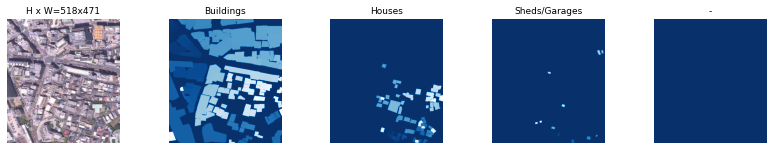

image                    shape: (518, 471, 3)         min:    0.00000  max:  255.00000  uint8
mask                     shape: (518, 471, 251)       min:    0.00000  max:    1.00000  bool
class_ids                shape: (251,)                min:    1.00000  max:    3.00000  int32
bbox                     shape: (251, 4)              min:    0.00000  max:  518.00000  int32


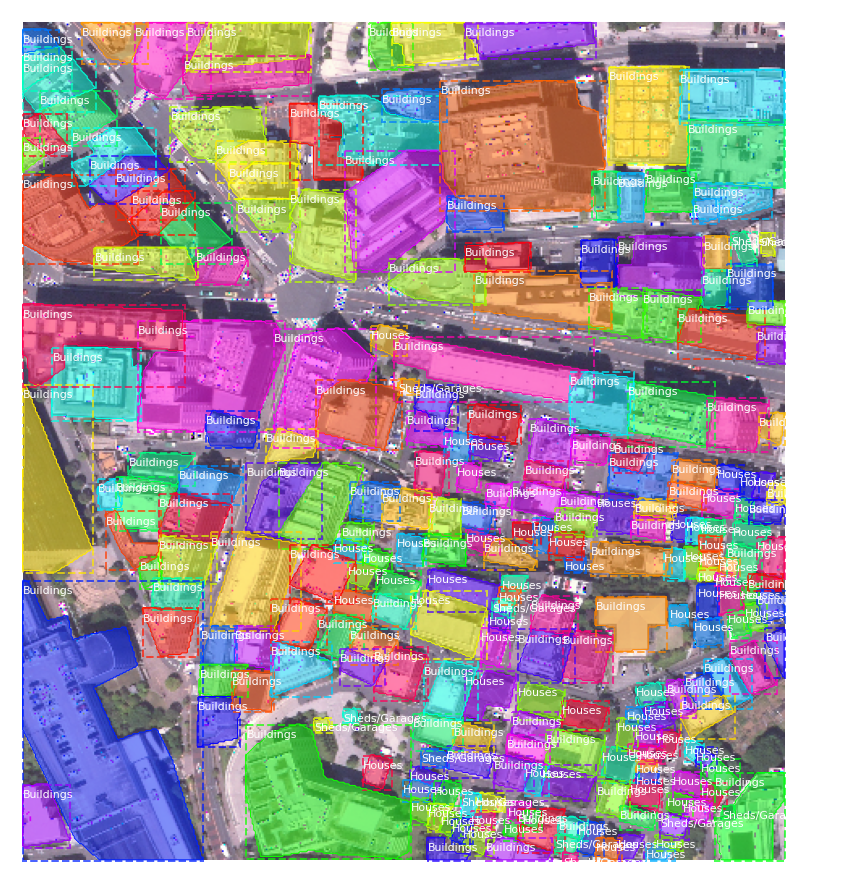

In [4]:
# verify dataset
print('verifying random sample from the loaded dataset..')

# Load and display random sample from training dataset
image_id = random.choice(dataset_train.image_ids)
print('image ID', image_id)
print('image path', dataset_train.image_info[image_id]['path'])
image = dataset_train.load_image(image_id)
mask, class_ids = dataset_train.load_mask(image_id)
visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)

# Display image and additional stats
bbox = utils.extract_bboxes(mask)
log("image", image)
log("mask", mask)
log("class_ids", class_ids)
log("bbox", bbox)
# print('image annotated data', dataset_train.image_reference(image_id))

# Display image and instances
visualize.display_instances(image, bbox, mask, class_ids, dataset_train.class_names)

## Mask RCNN configuration class

In [5]:
class SatelliteConfig(Config):
    """Configuration for training on the satellite dataset.
    """
    # Give the configuration a recognizable name
    NAME = "shapes"

    # Train on 1 GPU and 8 images per GPU. We can put multiple images on each
    # GPU because the images are small. Batch size is 8 (GPUs * images/GPU).
    GPU_COUNT = 1
    IMAGES_PER_GPU = 2

    # Number of classes (including background)
    NUM_CLASSES = 1 + 3  # background + 3 shapes

    # Use small images for faster training. Set the limits of the small side
    # the large side, and that determines the image shape.
    # NOTE: Exception: Image size must be dividable by 2 at least 6 times to
          # avoid fractions when downscaling and upscaling.
          # For example, use 256, 320, 384, 448, 512, ... etc. 
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512

    # Use smaller anchors because our image and objects are small
    RPN_ANCHOR_SCALES = (8, 16, 32, 64, 128)  # anchor side in pixels

    # Reduce training ROIs per image because the images are small and have
    # few objects. Aim to allow ROI sampling to pick 33% positive ROIs.
    TRAIN_ROIS_PER_IMAGE = 200

    # Use a large epoch since the data is complex
    STEPS_PER_EPOCH = 1000

    # Number of validation steps to run at the end of every training epoch.
    # A bigger number improves accuracy of validation stats, but slows
    # down the training.
    # use small validation steps since the epoch is small
    VALIDATION_STEPS = 50


    # Learning rate
    # The Mask RCNN paper uses lr=0.02, but on TensorFlow it causes
    # weights to explode. Likely due to differences in optimizer
    # implementation.
    LEARNING_RATE = 0.001

config = SatelliteConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                16
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE             

# TRAINING

## Create model in traininng mode

In [8]:

model = modellib.MaskRCNN(mode="training", config=config,
                        model_dir=MODEL_DIR)

# pick pre-trained model weights
# init_with = 'imagenet' # coco
# pick last weight
init_with = 'last'

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":
    model.load_weights(COCO_MODEL_PATH, by_name=True,
                        exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",
                        "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    # Load the last model you trained and continue training
    model.load_weights(model.find_last(), by_name=True)

Re-starting from epoch 131


## Start training

In [18]:
# Initially train only 'heads' layers for 50 epochs
# Futher train-finetune ResNet stage 4 onward layers for another 50 epochs
# finally train all layers for another 30 epochs

start_train = time.time()

#  Training - Stage 1
# Train the head branches
print("Training network heads")
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=50,
            layers='heads')

# Training - Stage 2
# Finetune layers from ResNet stage 4 onward layers
print("Fine tune Resnet stage 4 and up")
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=100,
            layers='4+')

# Training - Stage 3
# Fine tune all layers
print("Fine tune all layers")
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE / 10,
            epochs=131,
            layers='all')

end_train = time.time()
minutes = round((end_train - start_train) / 60, 2)
print(f'total training took {minutes} minutes')



Training network heads

Starting at epoch 0. LR=0.001

Checkpoint Path: logs/shapes20210312T1344/mask_rcnn_shapes_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mas

ImportError: `save_weights` requires h5py.

###  Manually save weights in case of interruption


In [11]:
# Typically not needed because callbacks save after every epoch
# Uncomment to save manually
# model_path = os.path.join(MODEL_DIR, "mask_rcnn_satellite_manual.h5")
# model.keras_model.save_weights(model_path)

# EVALUATION

## Create Model in validation mode

In [9]:
class InferenceConfig(SatelliteConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512
    DETECTION_MIN_CONFIDENCE = 0.2

inference_config = InferenceConfig()

# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference",
                          config=inference_config,
                          model_dir=MODEL_DIR)

# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
model_path = model.find_last()
print('most recent weight', model_path)

# Load trained weights
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

most recent weight Mask_RCNN/logs/shapes20210312T1707/mask_rcnn_shapes_0131.h5
Loading weights from  Mask_RCNN/logs/shapes20210312T1707/mask_rcnn_shapes_0131.h5
Re-starting from epoch 131


### Return a Matplotlib Axes array to be used in all visualizations in the notebook

In [10]:
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.

    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

## Test trained model on a random image


original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  518.00000  float64
gt_class_id              shape: (120,)                min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (120, 4)              min:    0.00000  max:  512.00000  int32
gt_mask                  shape: (512, 512, 120)       min:    0.00000  max:    1.00000  bool


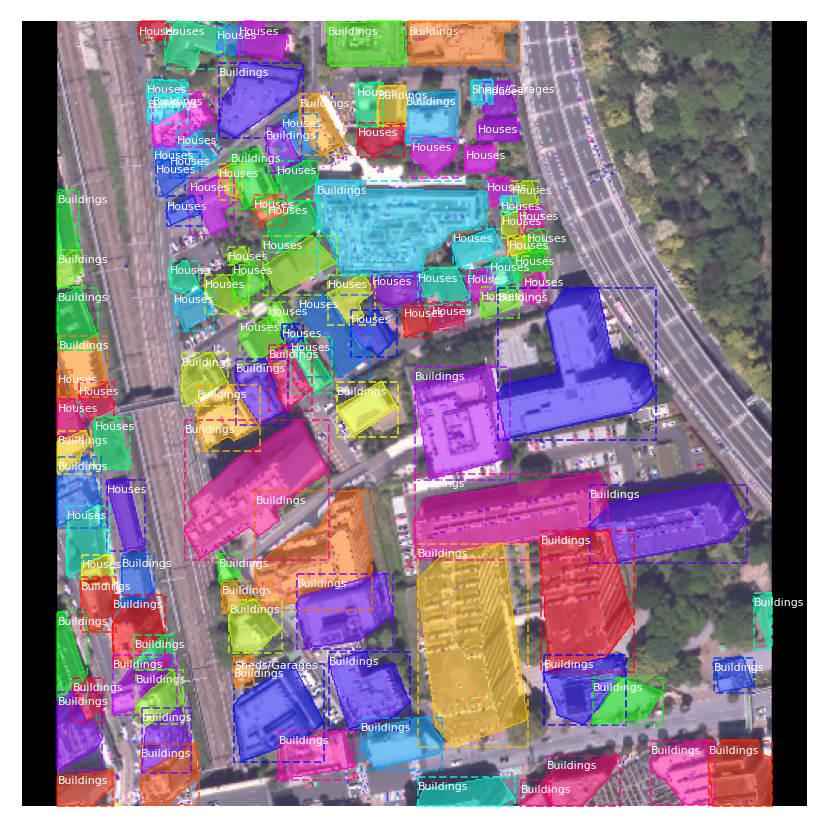

In [11]:
# load random sample
image_id = random.choice(dataset_val.image_ids)
original_image, image_meta, gt_class_id, gt_bbox, gt_mask = modellib.load_image_gt(dataset_val, inference_config,
                                                            image_id, use_mini_mask=False)

log("original_image", original_image)
log("image_meta", image_meta)
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

# visualizee ground truth
visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id,
                            dataset_train.class_names, figsize=(15, 15))


## Run prediction on same random sample as above

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


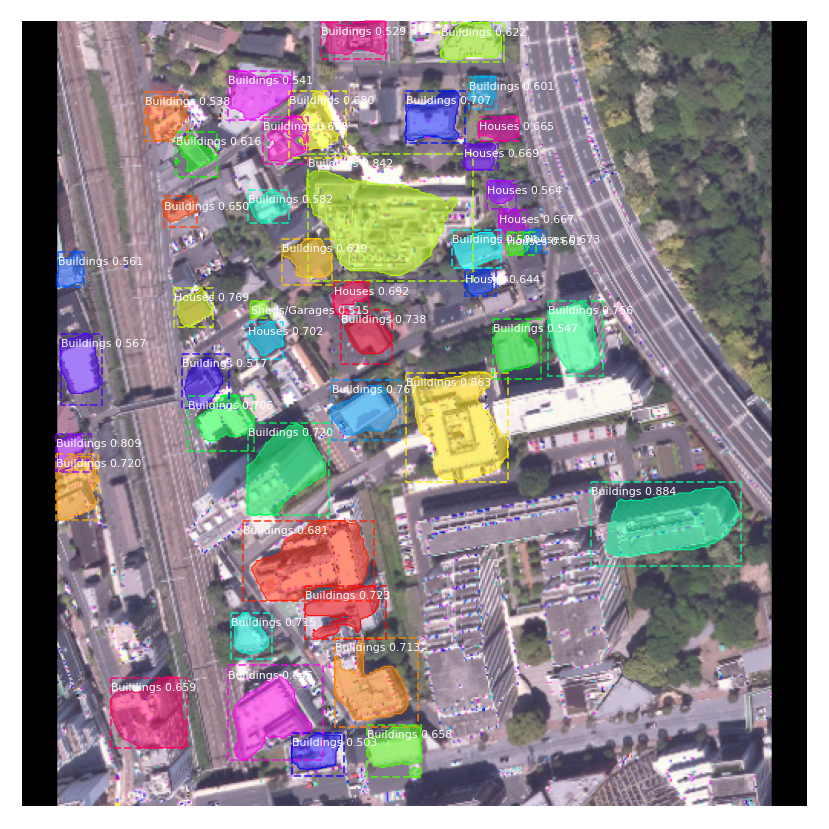

In [12]:
results = model.detect([original_image], verbose=1)
r = results[0]

# visualize
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'],
                            dataset_val.class_names, r['scores'],figsize=(15, 15))

## Calculate mean APs on all validation dataset and plot Precision-Recall Curve AP@50

mAP:  0.4386357971495798


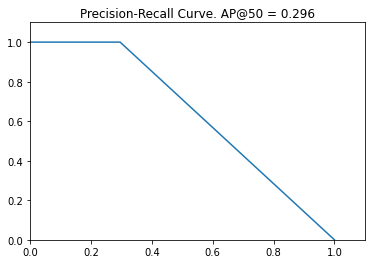

In [13]:
image_ids = np.random.choice(dataset_val.image_ids, len(dataset_val.image_ids))
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask = modellib.load_image_gt(dataset_val, inference_config,
                                                      image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)

    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]

    # Compute AP
    AP, precisions, recalls, overlaps =  utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    APs.append(AP)

print("mAP: ", np.mean(APs))

# visualize precision-recall curve
visualize.plot_precision_recall(AP, precisions, recalls)


## start tensorboard

In [362]:
# To run this command, you will need to copy and paste below line on local system's terminal or otherwise use google colab
 
!tensorboard --logdir Mask_RCNN/logs/


## Train and Validation loss plots (showing for two versions)

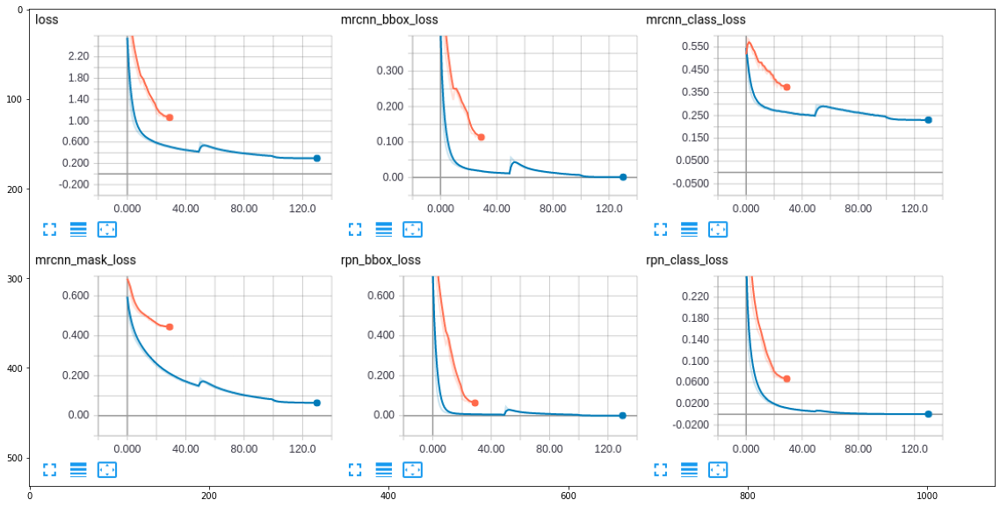

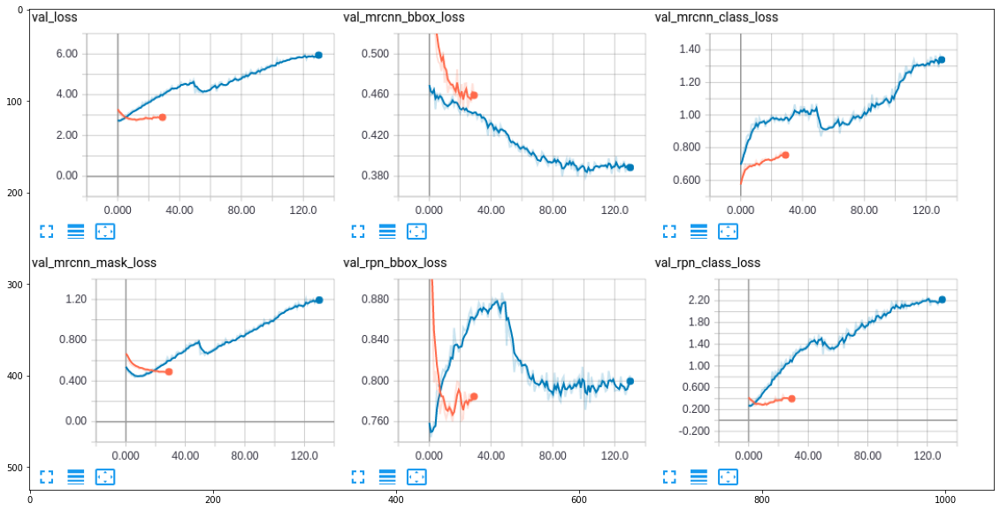

In [363]:
# read tensorboard screenshots
test_loss = plt.imread('test_loss.png')
train_loss = plt.imread('train_loss.png')

# visualize
fig, ax = plt.subplots(figsize =(20, 10))
plt.imshow(train_loss)
plt.show()

fig, ax = plt.subplots(figsize =(20, 10))
plt.imshow(test_loss)
plt.show()

## Run prediction on single sample of evaluation dataset

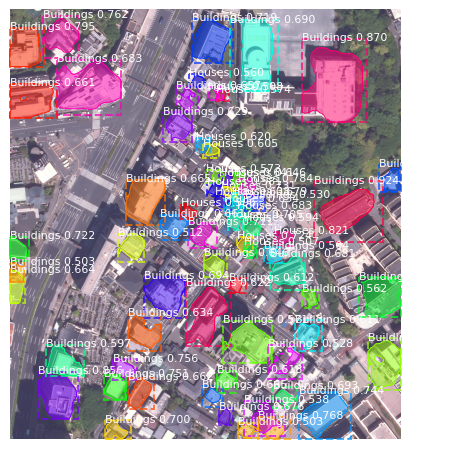

In [50]:
eval_image = skimage.io.imread(os.path.join(DATA_DIR, 'eval', eval_indices[0]))
predictions = model.detect([eval_image], verbose=0)
pred = predictions[0]

# visualize
visualize.display_instances(eval_image, pred['rois'], pred['masks'], pred['class_ids'],
                            dataset_val.class_names, pred['scores'],figsize=(8, 8))


## Run prediction on all evaluation dataset

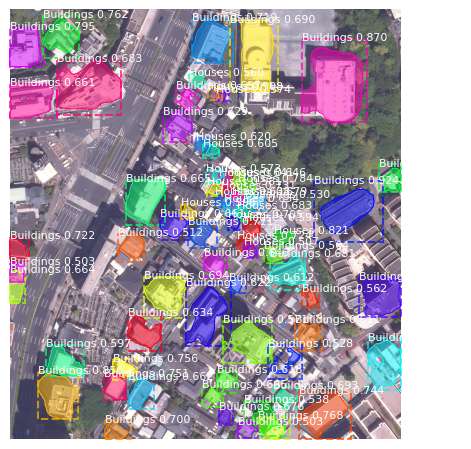

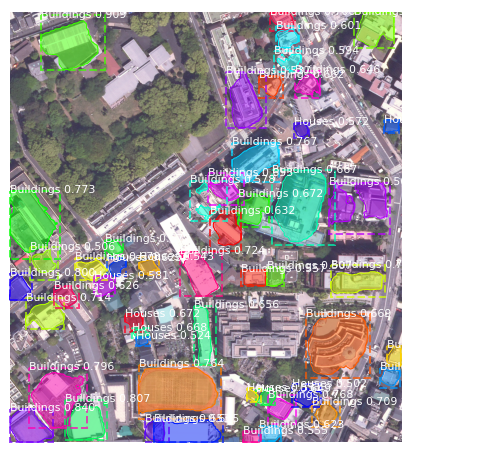

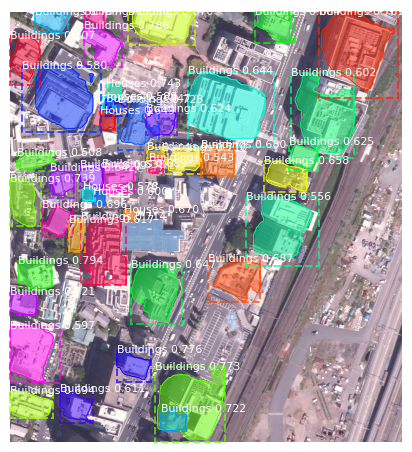

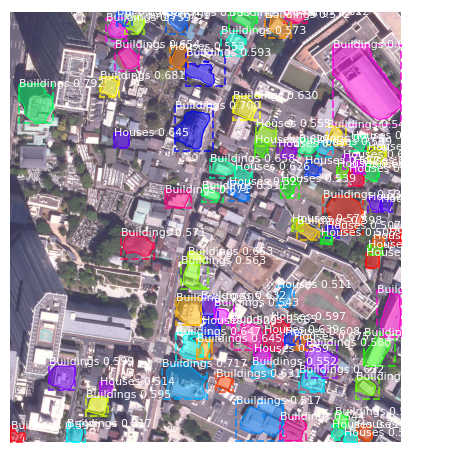

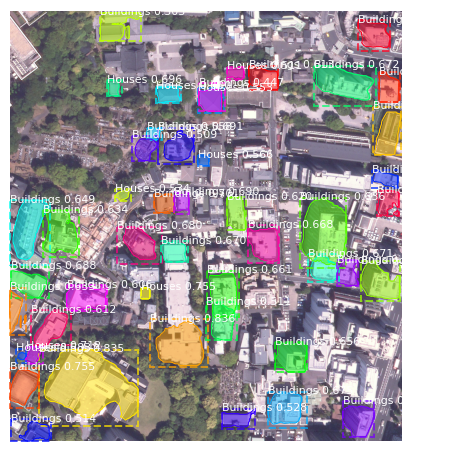

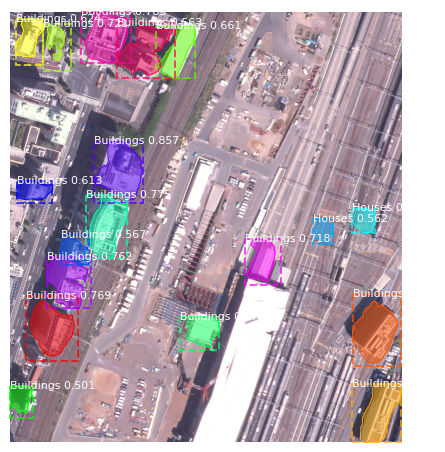

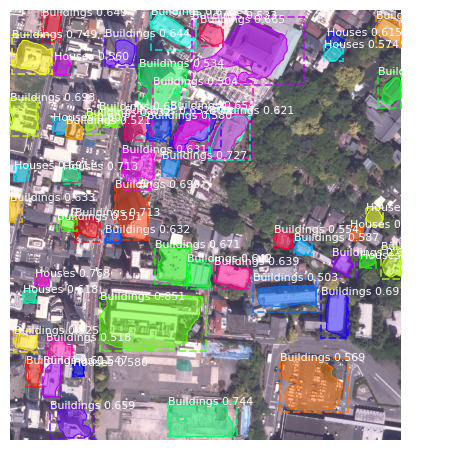

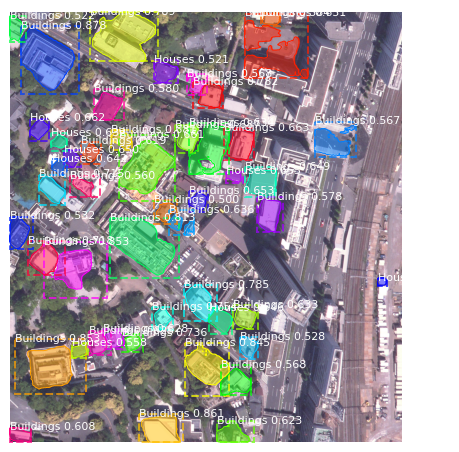

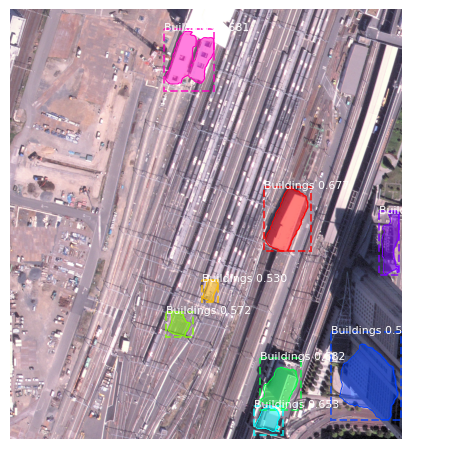

In [42]:

import skimage.io

for idx in eval_indices:
    eval_img_path = os.path.join(DATA_DIR, 'eval', idx)
    eval_image = skimage.io.imread(eval_img_path)
    predictions = model.detect([eval_image], verbose=0)
    pred = predictions[0]

    # visualize
    visualize.display_instances(eval_image, pred['rois'], pred['masks'], pred['class_ids'],
                                dataset_val.class_names, pred['scores'],figsize=(8, 8))



## Export predicted data and other information to JSON file

In [343]:
import skimage.io

# function to reshape np.array into list of x1,y1...xn,yn
def vertices_to_list(vertices):
    v = []
    for i in range(len(vertices)):
        v.append(vertices.tolist()[i][0]) #x
        v.append(vertices.tolist()[i][1]) #y 
    return v   


# function to retrieve predicted polygon coordinates
def mask_to_json(i, pred):
    
    annotations = {}
    annotations["id"] = i
    
    # find coordinates of predicted masks            
    mask = pred["masks"].astype(np.uint8)[:, :, i]
    ret, thresh = cv2.threshold(mask, 0, 255, cv2.THRESH_BINARY)
    vertices, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    vertices = vertices[0].reshape(-1,2)
    annotations['segmentation'] = vertices_to_list(vertices)

    return annotations

export_data = {} # {fileName, labels}

# iterate and predict through each file in the data/eval
for idx, img in enumerate(eval_indices):
    
    eval_img_path = os.path.join(DATA_DIR, 'eval', img)
    export_data['fileName'] = img
    eval_image = skimage.io.imread(eval_img_path)
    predictions = model.detect([eval_image], verbose=0)
    pred = predictions[0]

    # for each pred_mask
    list_labels = [] # [{class_name, list_annotations}]
    annotations_cls1 = [] # [{id, segmentation}]
    annotations_cls2 = []
    annotations_cls3 = []

    for i, class_id in enumerate(pred["class_ids"]):

        if class_id == 1:
            annotations_cls1.append(mask_to_json(i, pred))
        elif class_id == 2:
            annotations_cls2.append(mask_to_json(i, pred))
        elif class_id == 3:
            annotations_cls3.append(mask_to_json(i, pred))

    labels = {}
                
    labels['name'] = class_names[1]
    labels['annotations'] = annotations_cls1
    list_labels.append(labels.copy())

    labels['name'] = class_names[2]
    labels['annotations'] = annotations_cls2
    list_labels.append(labels.copy())

    labels['name'] = class_names[3]
    labels['annotations'] = annotations_cls3
    list_labels.append(labels.copy())
    
    export_data['labels'] = list_labels
        
    # export predicted polygons to json file
    import json
    export_file = "predicted_output_" + export_data['fileName'] + ".json"
    export_file = os.path.join('data', 'eval', export_file)
    out = open(export_file, "w")
    out.write(json.dumps(export_data))
    out.close()
    print("exported predicted output of {} to {}".format(export_data['fileName'], export_file))



exported predicted output of 6_6.png to data/eval/predicted_output_6_6.png.json
exported predicted output of 6_7.png to data/eval/predicted_output_6_7.png.json
exported predicted output of 6_8.png to data/eval/predicted_output_6_8.png.json
exported predicted output of 7_6.png to data/eval/predicted_output_7_6.png.json
exported predicted output of 7_7.png to data/eval/predicted_output_7_7.png.json
exported predicted output of 7_8.png to data/eval/predicted_output_7_8.png.json
exported predicted output of 8_6.png to data/eval/predicted_output_8_6.png.json
exported predicted output of 8_7.png to data/eval/predicted_output_8_7.png.json
exported predicted output of 8_8.png to data/eval/predicted_output_8_8.png.json
